# Determine CD16+ T cells

Here we examine whether we can identify CD16+ T cells in the CITE-seq data. For this purpose, we have inferred the foreground protein abundance with TotalVI and computed a joint embedding of both RNA and protein space. We use the joint latent embedding to determine reliable thresholds for the definition of CD16+ T cells.  

In [1]:
import scanpy as sc
import anndata as ann
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
import mudata as md
import muon as mu
#import scvi

C:\Users\vfriedrich\Anaconda3\envs\scanpy\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [6]:
import seaborn as sns
import os

In [3]:
sc.logging.print_header()

scanpy==1.9.3 anndata==0.8.0 umap==0.5.3 numpy==1.23.5 scipy==1.10.1 pandas==1.5.3 scikit-learn==1.2.2 statsmodels==0.13.5 pynndescent==0.5.8


## Set paths

In [11]:
#file_path = '/home/marenbuettner/development/citeseq_integration/'
file_path = os.getcwd()
#this is my file path please adapt it to your directory

The data directory contains all processed data and `anndata` files. 

In [17]:
data_dir = os.path.join("C:\\Users\\vfriedrich\\projects\\gating\\","reproducibility_cleaned",
             "main_Figure_bridge_gap",
             "CITEseq",
            "input_data\\")

In [5]:
#data_dir = file_path + 'data/' 

Raw data path is the directory of the primary data, which are used in the project. 

In [6]:
#data_raw_dir = '/home/marenbuettner/public_data/covid_citeseq_stephenson2021/'

The default figure path is a POSIX path calles 'figures'. If you don't change the default figure directory, scanpy creates a subdirectory where this notebook is located.  

In [12]:
sc.settings.figdir = file_path + 'figures/'

**Comment:** When you repeat certain analyses, it might be helpful to set a date variable and add it to every figure and table (see `datetime` Python package).

In [13]:
import datetime

today = datetime.date.today().strftime('%y%m%d') #creates a YYMMDD string of today's date

## Read data

Due to some issues with the joint `var_names` in the `MuData` object, we have to load the modalities separately:  

In [18]:
adata = md.read(f'{data_dir}haniffa21_totalVI_Covid_Healthy.h5mu/rna')

In [19]:
pdata = md.read(f'{data_dir}haniffa21_totalVI_Covid_Healthy.h5mu/protein')

In [20]:
adata_subset = md.read_h5ad(f'{data_dir}haniffa21_totalVI_Covid_Healthy.h5mu', mod='rna_subset')

In [21]:
adata

AnnData object with n_obs × n_vars = 624325 × 24737
    obs: 'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'full_clustering', 'initial_clustering', 'Resample', 'Collection_Day', 'Sex', 'Age_interval', 'Swab_result', 'Status', 'Smoker', 'Status_on_day_collection', 'Status_on_day_collection_summary', 'Days_from_onset', 'Site', 'time_after_LPS', 'Worst_Clinical_Status', 'Outcome', 'patient_id'
    var: 'feature_types', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    layers: 'raw'

In [22]:
pdata

AnnData object with n_obs × n_vars = 624325 × 192
    obs: 'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'full_clustering', 'initial_clustering', 'Resample', 'Collection_Day', 'Sex', 'Age_interval', 'Swab_result', 'Status', 'Smoker', 'Status_on_day_collection', 'Status_on_day_collection_summary', 'Days_from_onset', 'Site', 'time_after_LPS', 'Worst_Clinical_Status', 'Outcome', 'patient_id', '_scvi_batch'
    var: 'feature_types'
    uns: 'hvg', 'leiden', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    layers: 'denoised_protein', 'protein_foreground_prob', 'raw'

In [23]:
adata_subset

AnnData object with n_obs × n_vars = 624325 × 3000
    obs: 'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'full_clustering', 'initial_clustering', 'Resample', 'Collection_Day', 'Sex', 'Age_interval', 'Swab_result', 'Status', 'Smoker', 'Status_on_day_collection', 'Status_on_day_collection_summary', 'Days_from_onset', 'Site', 'time_after_LPS', 'Worst_Clinical_Status', 'Outcome', 'patient_id', '_scvi_batch', 'leiden_totalVI'
    var: 'feature_types', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_totalVI', 'X_umap'
    layers: 'denoised_rna', 'raw'
    obsp: 'connectivities', 'distances'

Reconstruct the MuData object.

In [24]:
mdata = md.MuData({"rna": adata, "protein": pdata, "rna_subset": adata_subset})
mdata

C:\Users\vfriedrich\Anaconda3\envs\scanpy\lib\site-packages\mudata\_core\mudata.py:491: UserWarning: Cannot join columns with the same name because var_names are intersecting.
  warnings.warn(


MuData object with n_obs × n_vars = 624325 × 27929
  3 modalities
    rna:	624325 x 24737
      obs:	'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'full_clustering', 'initial_clustering', 'Resample', 'Collection_Day', 'Sex', 'Age_interval', 'Swab_result', 'Status', 'Smoker', 'Status_on_day_collection', 'Status_on_day_collection_summary', 'Days_from_onset', 'Site', 'time_after_LPS', 'Worst_Clinical_Status', 'Outcome', 'patient_id'
      var:	'feature_types', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
      uns:	'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'umap'
      obsm:	'X_pca', 'X_pca_harmony', 'X_umap'
      layers:	'raw'
    protein:	624325 x 192
      obs:	'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'full_clustering', 'initial_clustering', 'Resample', 'Collection_Day', 'Sex', 'Age_interval', 'Swab_result', 'Status', 'Smoker', 'Status_on_day_collection', 'Status_on_day_collection_summary', 'Days_from_onset', 'Site', 'time_after_LPS', 'Worst_Clinical_Status', 'Outcome', 'patient_id', '_scvi_batch'
      var:	'feature_types'
      uns:	'hvg', 'leiden', 'neighbors', 'pca', 'umap'
      obsm:	'X_pca', 'X_pca_harmony', 'X_umap'
      layers:	'denoised_protein', 'protein_foreground_prob', 'raw'
    rna_subset:	624325 x 3000
      obs:	'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'full_clustering', 'initial_clustering', 'Resample', 'Collection_Day', 'Sex', 'Age_interval', 'Swab_result', 'Status', 'Smoker', 'Status_on_day_collection', 'Status_on_day_collection_summary', 'Days_from_onset', 'Site', 'time_after_LPS', 'Worst_Clinical_Status', 'Outcome', 'patient_id', '_scvi_batch', 'leiden_totalVI'
      var:	'feature_types', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
      uns:	'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'umap'
      obsm:	'X_pca', 'X_pca_harmony', 'X_totalVI', 'X_umap'
      layers:	'denoised_rna', 'raw'
      obsp:	'connectivities', 'distances'

## Visualize data

C:\Users\vfriedrich\Anaconda3\envs\scanpy\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
C:\Users\vfriedrich\Anaconda3\envs\scanpy\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
C:\Users\vfriedrich\Anaconda3\envs\scanpy\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


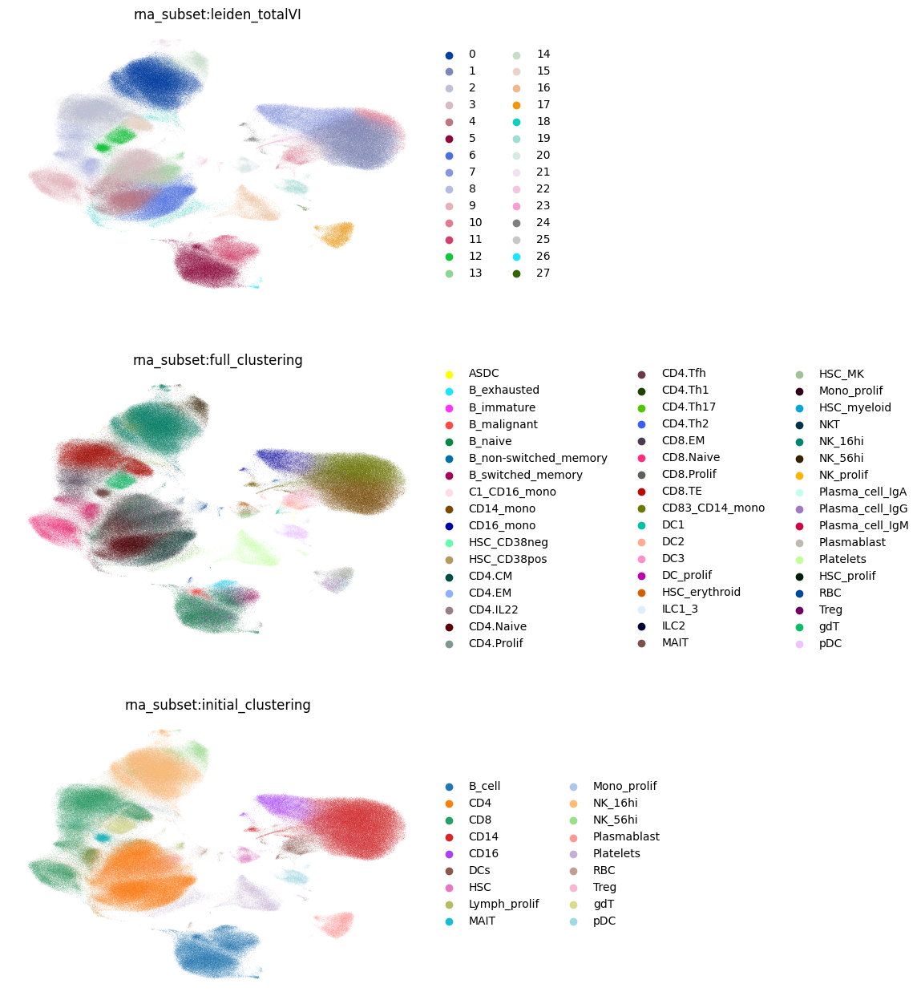

In [25]:
mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    color=["rna_subset:leiden_totalVI", "rna_subset:full_clustering", 'rna_subset:initial_clustering'],
    frameon=False,
    ncols=1,
)

C:\Users\vfriedrich\Anaconda3\envs\scanpy\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


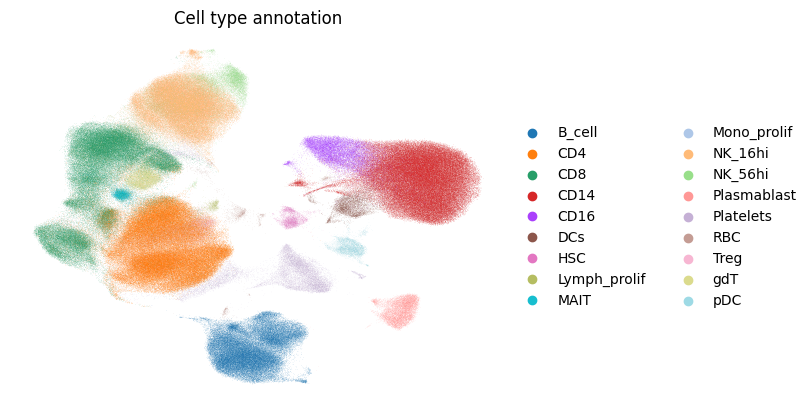

In [26]:
mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    color=['rna_subset:initial_clustering'],
    frameon=False,
    ncols=1,
    title='Cell type annotation',
    save='cell_typing.pdf'
)

C:\Users\vfriedrich\Anaconda3\envs\scanpy\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


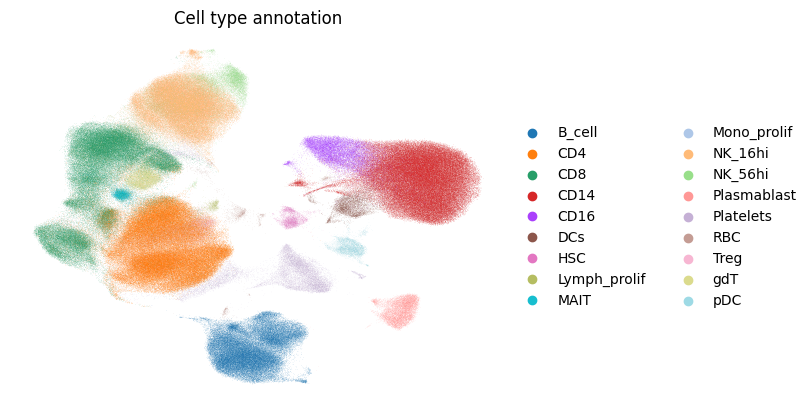

In [27]:
mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    color=['rna_subset:initial_clustering'],
    frameon=False,
    ncols=1,
    title='Cell type annotation',
    save='cell_typing.png'
)

C:\Users\vfriedrich\Anaconda3\envs\scanpy\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
C:\Users\vfriedrich\Anaconda3\envs\scanpy\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


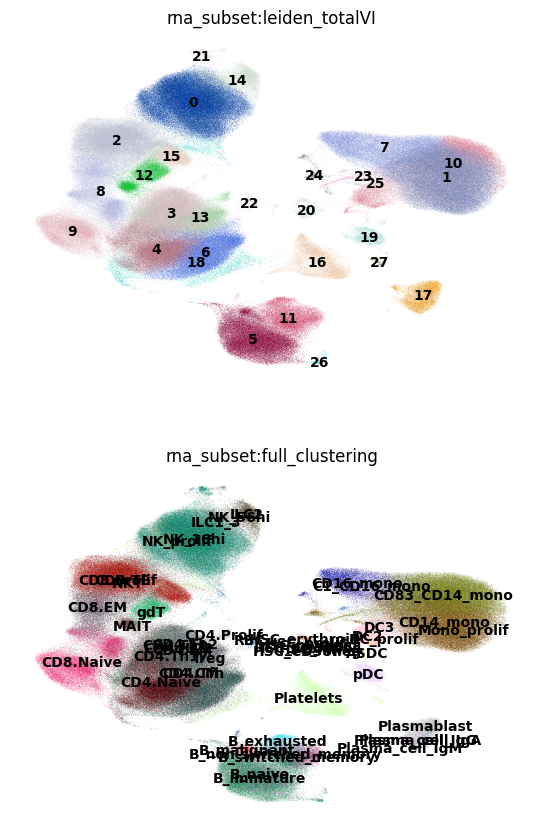

In [28]:
mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    color=["rna_subset:leiden_totalVI", "rna_subset:full_clustering"],
    frameon=False,
    ncols=1,
    legend_loc='on data'
)

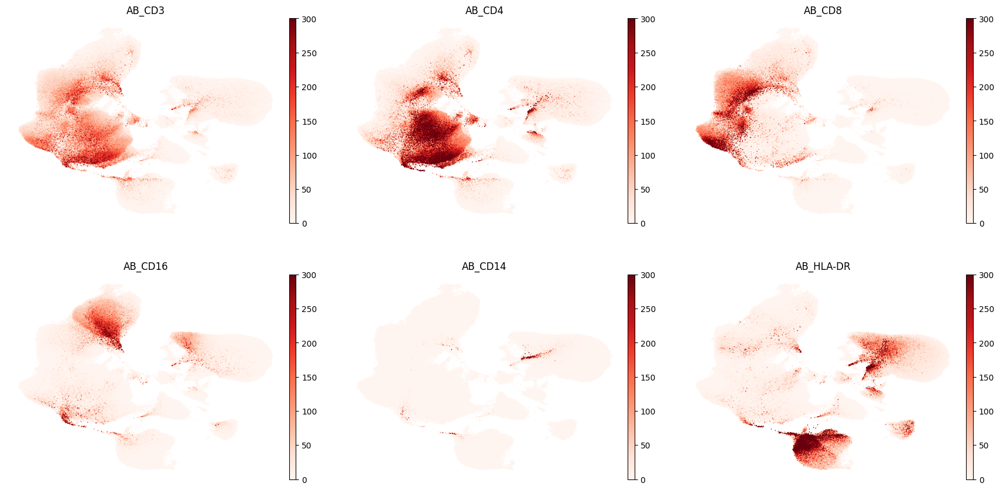

In [29]:
mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    color=['AB_CD3', 'AB_CD4', 'AB_CD8', 'AB_CD16', 'AB_CD14', 'AB_HLA-DR'],
    frameon=False,
    ncols=3,
    vmax=300,
    wspace=0.1,
    cmap='Reds',
    size=5,
    layer="denoised_protein",
)

In [30]:
pdata.obs['leiden_totalVI']=mdata.mod['rna_subset'].obs['leiden_totalVI'].copy()

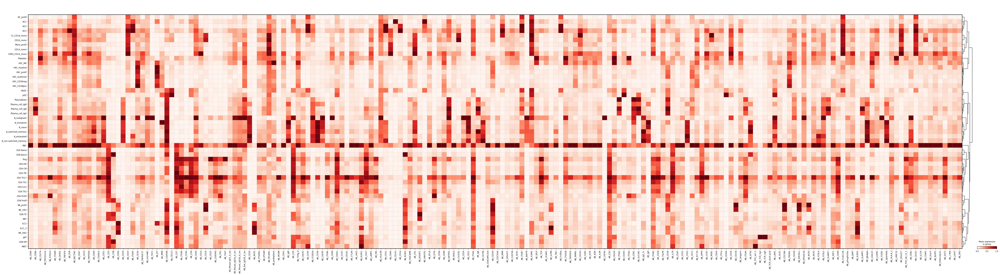

In [31]:
sc.pl.matrixplot(pdata, groupby='full_clustering', dendrogram=True,
                 var_names=pdata.var_names, standard_scale='var', log=True,
                 cmap='Reds', layer='denoised_protein')

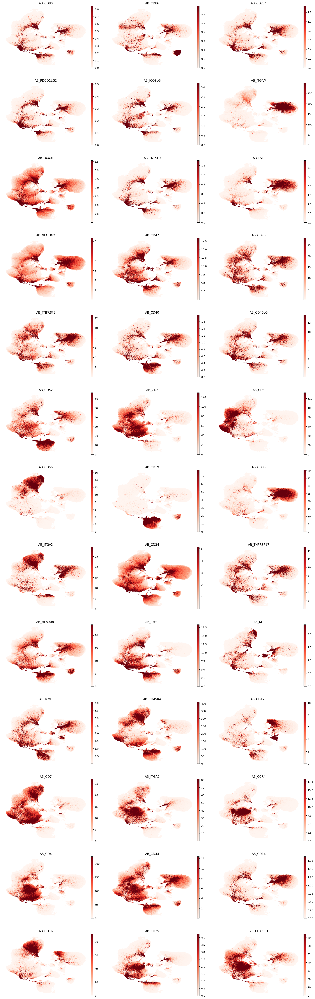

In [32]:
mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    color=pdata.var_names[:39],
    frameon=False,
    ncols=3,
    vmax="p99",
    wspace=0.1,
    cmap='Reds',
    size=5,
    layer="denoised_protein",
)

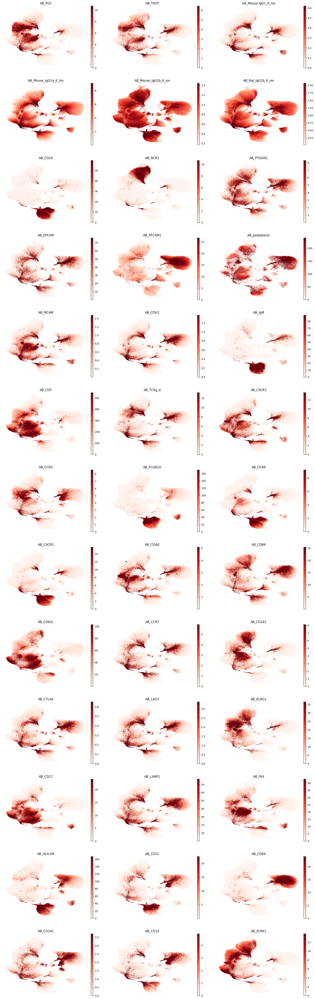

In [33]:
mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    color=pdata.var_names[39:][:39],
    frameon=False,
    ncols=3,
    vmax="p99",
    wspace=0.1,
    cmap='Reds',
    size=5,
    layer="denoised_protein",
)

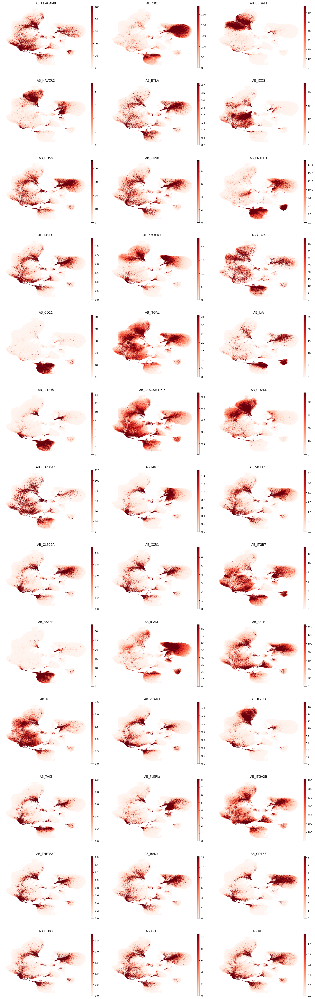

In [34]:
mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    color=pdata.var_names[78:][:39],
    frameon=False,
    ncols=3,
    vmax="p99",
    wspace=0.1,
    cmap='Reds',
    size=5,
    layer="denoised_protein",
)

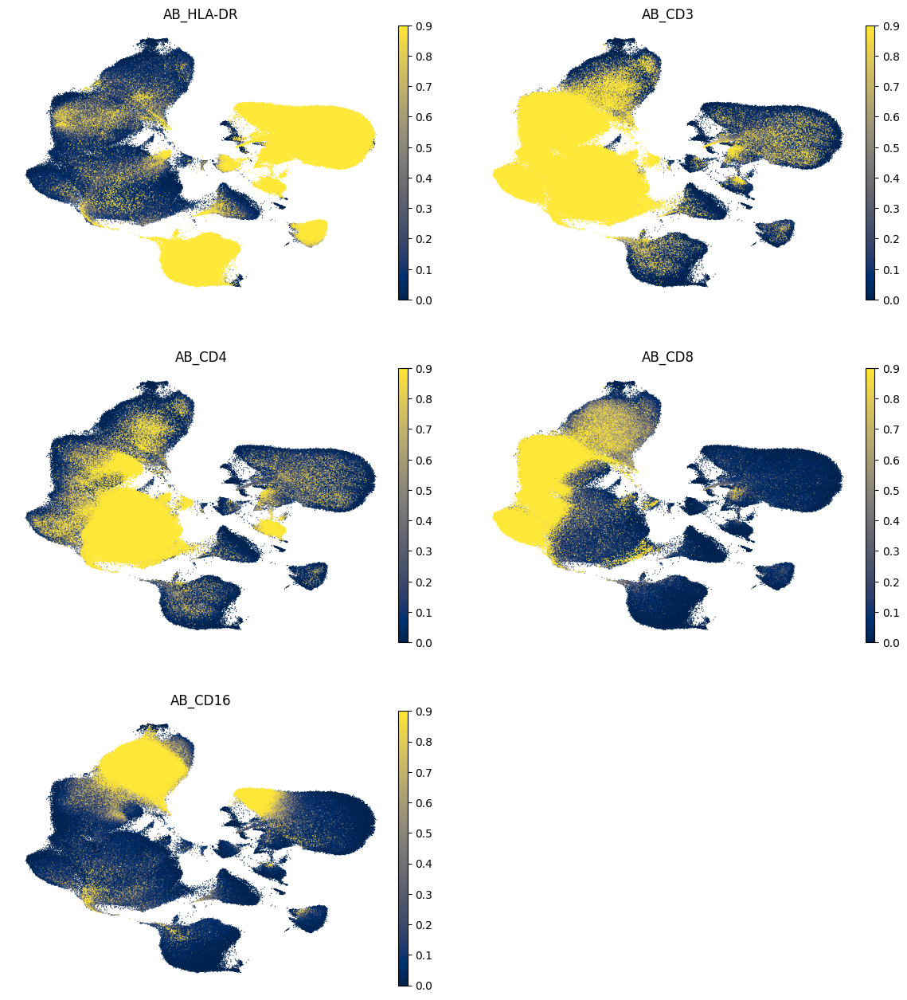

In [35]:
mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    layer="protein_foreground_prob",
    color=['AB_HLA-DR','AB_CD3', 'AB_CD4', 'AB_CD8', 'AB_CD16', ],
    frameon=False,
    ncols=2,
    vmax=0.9,
    size=3,
    wspace=0.1,
    color_map="cividis",
)

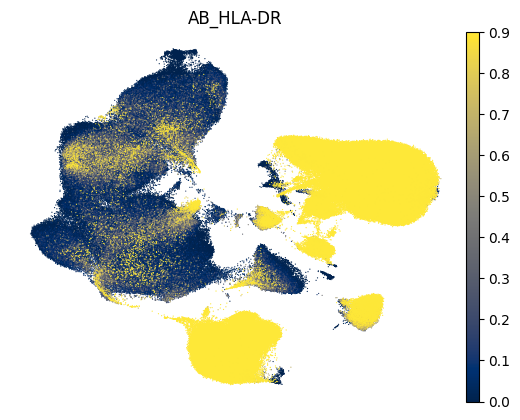

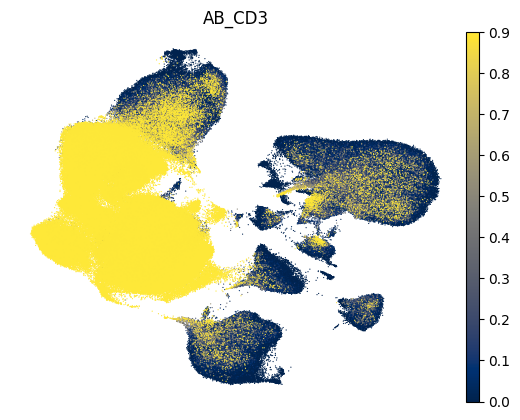

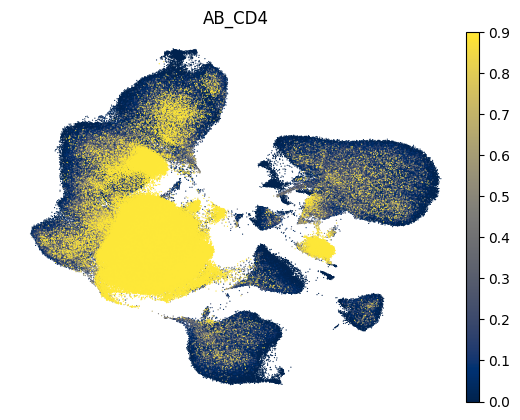

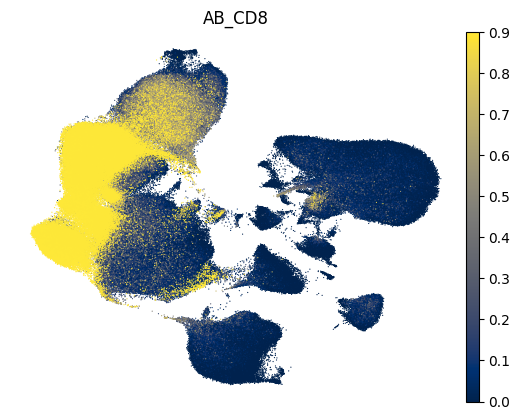

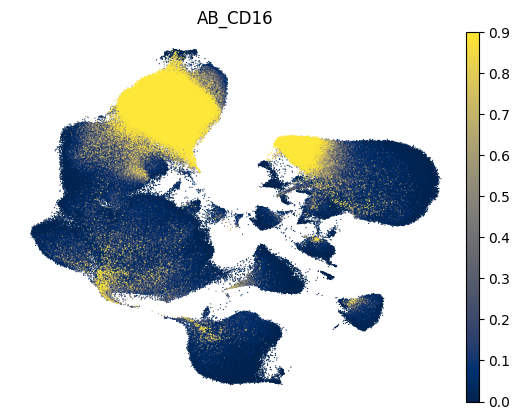

In [36]:
for key in ['AB_HLA-DR','AB_CD3', 'AB_CD4', 'AB_CD8', 'AB_CD16']:
    mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    layer="protein_foreground_prob",
    color=key,
    frameon=False,
    ncols=2,
    vmax=0.9,
    size=3,
    wspace=0.1,
    color_map="cividis",
        save=f"p_foreground_{key}.pdf"
)

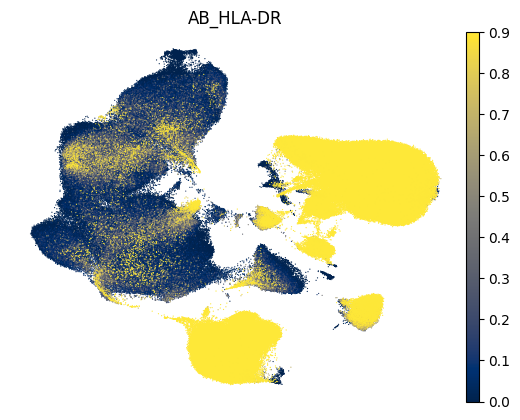

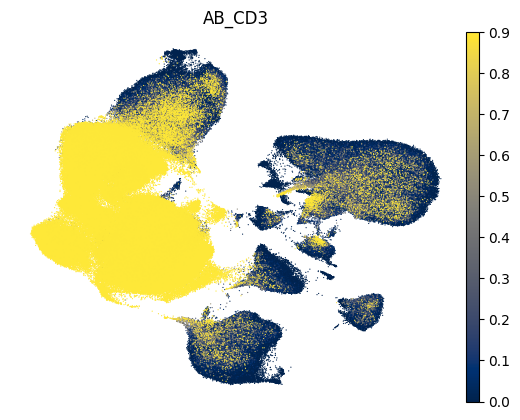

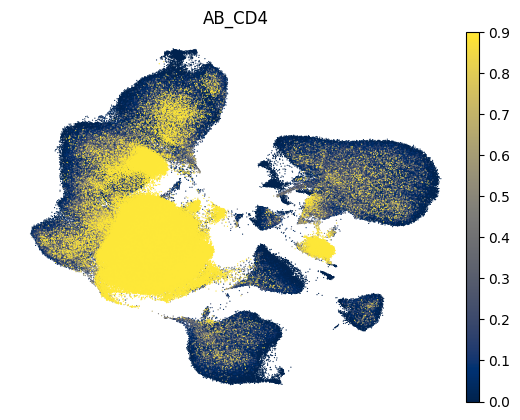

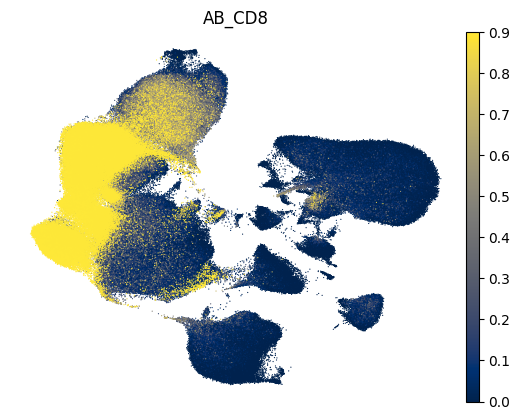

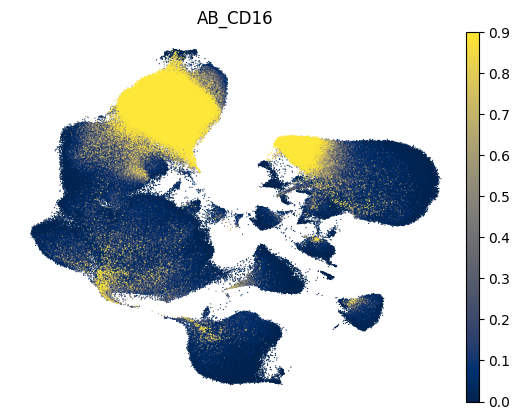

In [37]:
for key in ['AB_HLA-DR','AB_CD3', 'AB_CD4', 'AB_CD8', 'AB_CD16']:
    mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    layer="protein_foreground_prob",
    color=key,
    frameon=False,
    ncols=2,
    vmax=0.9,
    size=3,
    wspace=0.1,
    color_map="cividis",
        save=f"p_foreground_{key}.png"
)

In [39]:
pdata

AnnData object with n_obs × n_vars = 624325 × 192
    obs: 'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'full_clustering', 'initial_clustering', 'Resample', 'Collection_Day', 'Sex', 'Age_interval', 'Swab_result', 'Status', 'Smoker', 'Status_on_day_collection', 'Status_on_day_collection_summary', 'Days_from_onset', 'Site', 'time_after_LPS', 'Worst_Clinical_Status', 'Outcome', 'patient_id', '_scvi_batch', 'leiden_totalVI'
    var: 'feature_types'
    uns: 'hvg', 'leiden', 'neighbors', 'pca', 'umap', 'dendrogram_full_clustering'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    layers: 'denoised_protein', 'protein_foreground_prob', 'raw'

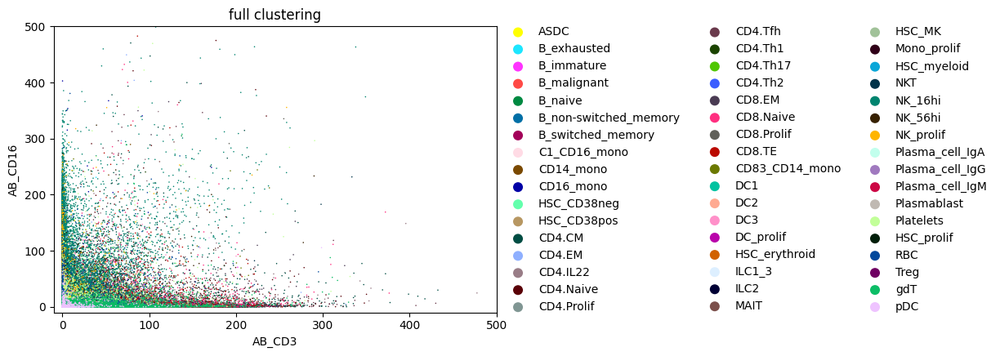

In [40]:
ax = sc.pl.scatter(pdata, x='AB_CD3', y='AB_CD16', color='full_clustering', show=False, size=5, layers='denoised_protein')
ax.set_xlim([-10, 500])
ax.set_ylim([-10, 500])
plt.show()

## Determine threshold for CD16+ cells

We are looking for HLA-DR+ CD16+ T cells (both CD4 and CD8 compartment). 

In [41]:
cd4_comp = []
cd8_comp = []

for group in adata.obs['initial_clustering'].cat.categories:
    
    if group.startswith('CD4'):
        cd4_comp.append(group)
    elif group.startswith('CD8'):
        cd8_comp.append(group)

In [42]:
pdata_t_cell = pdata[pdata.obs['initial_clustering'].isin(cd4_comp + cd8_comp)].copy()

In [43]:
prob_cd16 = pdata_t_cell.layers['protein_foreground_prob'][:, pdata.var_names =='AB_CD16'].squeeze()
prob_hladr = pdata_t_cell.layers['protein_foreground_prob'][:, pdata.var_names =='AB_HLA-DR'].squeeze()

In [44]:
pdata_t_cell.obs['prob_cd16'] = prob_cd16
pdata_t_cell.obs['prob_hladr'] = prob_hladr

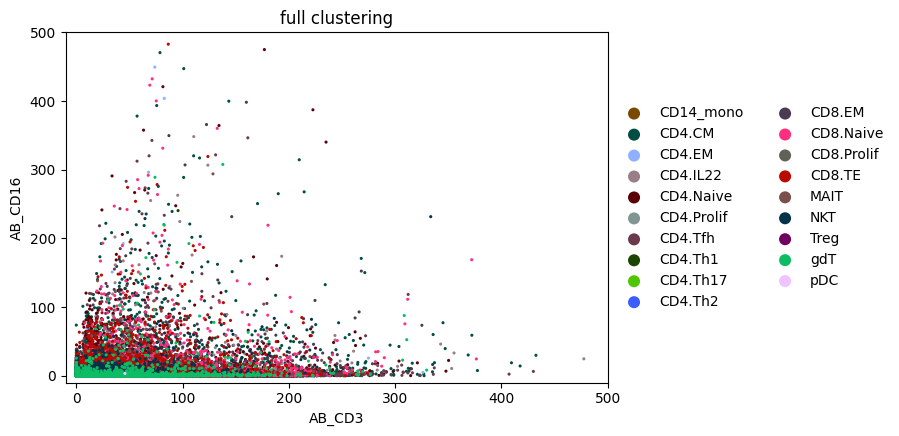

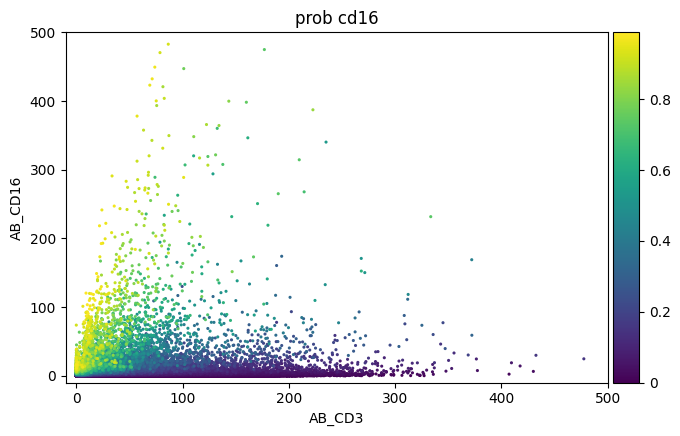

In [45]:
ax = sc.pl.scatter(pdata_t_cell, x='AB_CD3', y='AB_CD16', 
                   color='full_clustering', show=False, size=20, layers='denoised_protein')
ax.set_xlim([-10, 500])
ax.set_ylim([-10, 500])
plt.show()

ax = sc.pl.scatter(pdata_t_cell, x='AB_CD3', y='AB_CD16', 
                   color='prob_cd16', show=False, size=20, layers='denoised_protein')
ax.set_xlim([-10, 500])
ax.set_ylim([-10, 500])
plt.savefig('../testsfigures/scatter_cd3_cd16_Tcells.pdf')
plt.savefig('../testsfigures/scatter_cd3_cd16_Tcells.png')
plt.show()

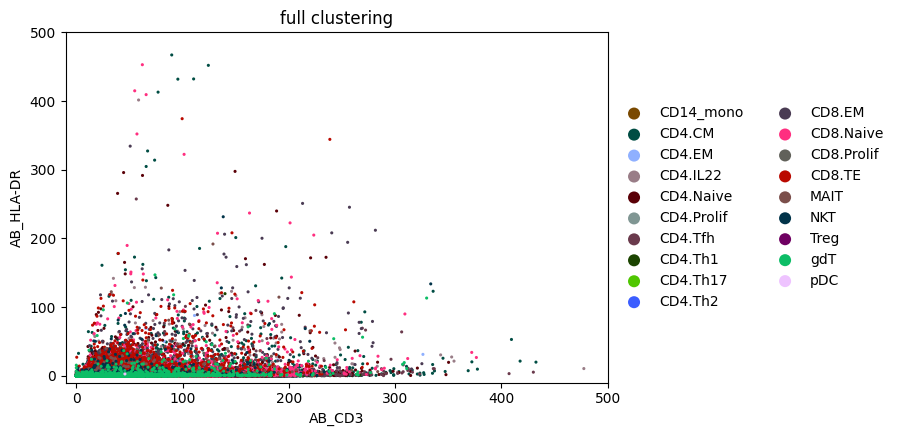

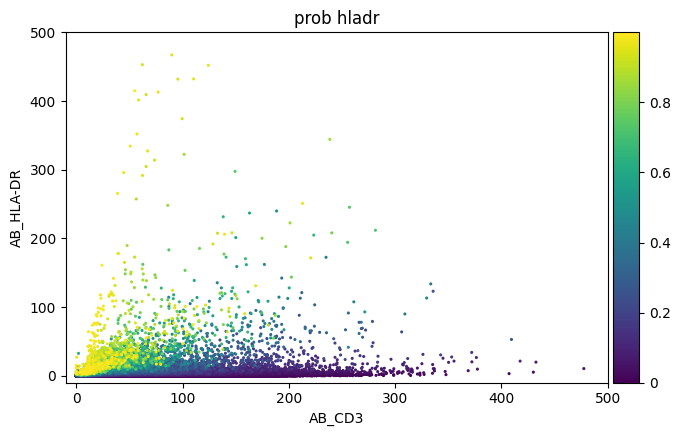

In [46]:
ax = sc.pl.scatter(pdata_t_cell, x='AB_CD3', y='AB_HLA-DR', 
                   color='full_clustering', show=False, size=20, layers='denoised_protein')
ax.set_xlim([-10, 500])
ax.set_ylim([-10, 500])
plt.show()

ax = sc.pl.scatter(pdata_t_cell, x='AB_CD3', y='AB_HLA-DR', 
                   color='prob_hladr', show=False, size=20, layers='denoised_protein')
ax.set_xlim([-10, 500])
ax.set_ylim([-10, 500])
plt.savefig('../testsfigures/scatter_cd3_hladr_Tcells.pdf')
plt.savefig('../testsfigures/scatter_cd3_hladr_Tcells.png')
plt.show()

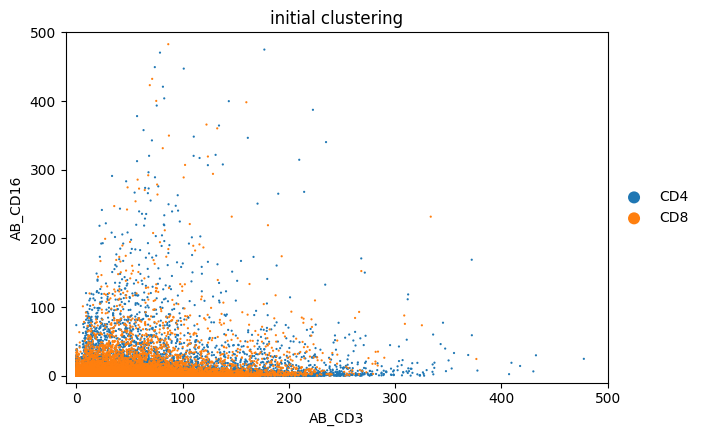

In [47]:
ax = sc.pl.scatter(pdata_t_cell, x='AB_CD3', y='AB_CD16', 
                   color='initial_clustering', 
                   #alpha=0.8,
                   show=False, 
                   size=10,
                   layers='denoised_protein')
ax.set_xlim([-10, 500])
ax.set_ylim([-10, 500])
plt.show()

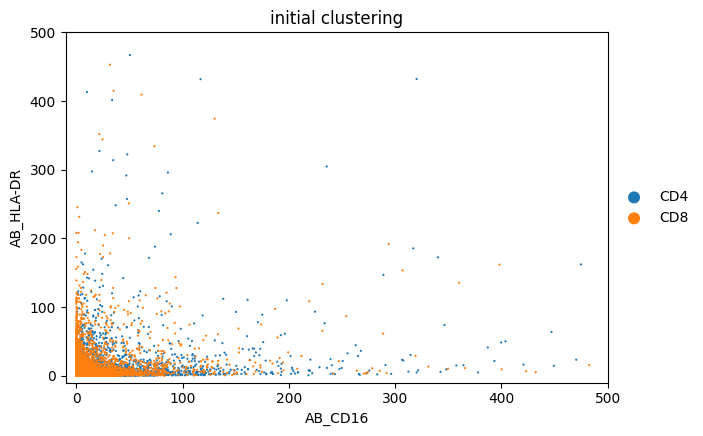

In [48]:
ax = sc.pl.scatter(pdata_t_cell, x='AB_CD16', y='AB_HLA-DR', 
                   color='initial_clustering', 
                   #alpha=0.8,
                   show=False, 
                   size=10,
                   layers='denoised_protein')
ax.set_xlim([-10, 500])
ax.set_ylim([-10, 500])
plt.savefig('../testsfigures/scatter_cd16_hladr_Tcells.pdf')
plt.savefig('../testsfigures/scatter_cd16_hladr_Tcells.png')
plt.show()

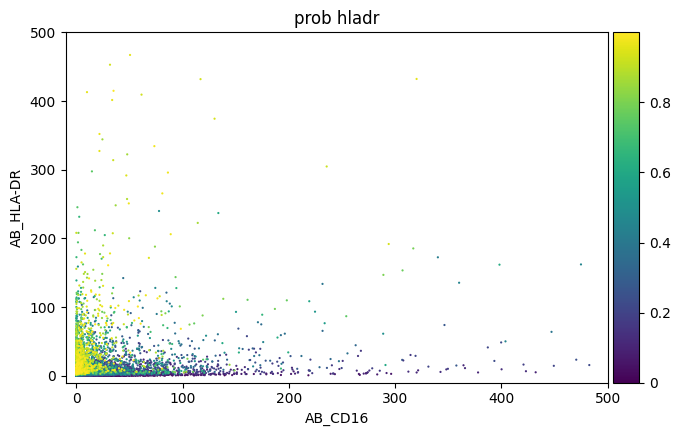

In [49]:
ax = sc.pl.scatter(pdata_t_cell, x='AB_CD16', y='AB_HLA-DR', 
                   color='prob_hladr', 
                   #alpha=0.8,
                   show=False, 
                   size=10,
                   layers='denoised_protein')
ax.set_xlim([-10, 500])
ax.set_ylim([-10, 500])
plt.show()

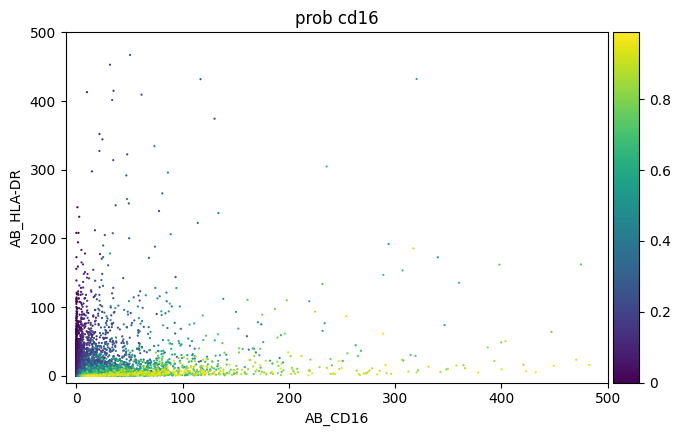

In [50]:
ax = sc.pl.scatter(pdata_t_cell, x='AB_CD16', y='AB_HLA-DR', 
                   color='prob_cd16', 
                   #alpha=0.8,
                   show=False, 
                   size=10,
                   layers='denoised_protein')
ax.set_xlim([-10, 500])
ax.set_ylim([-10, 500])
plt.show()

We use a threshold of P(CD16, foreground) > 0.5 to define CD16 positive cells.

We also use a threshold of P(HLA-DR, foreground) > 0.5 to define HLA-DR positive cells.

In [51]:
pdata_t_cell[pdata_t_cell.obs['prob_cd16']>=0.5].obs[['initial_clustering','Status']].value_counts()

initial_clustering  Status 
CD8                 Covid      1027
CD4                 Covid       884
CD8                 Healthy     222
CD4                 Healthy      84
dtype: int64

In [52]:
pdata_t_cell[pdata_t_cell.obs['prob_hladr']>=0.5].obs[['initial_clustering','Status']].value_counts()

initial_clustering  Status 
CD8                 Covid      1743
CD4                 Covid      1168
                    Healthy     157
CD8                 Healthy     134
dtype: int64

Let us combine the counts for both HLA-DR and CD16.

In [53]:
pdata_t_cell[(pdata_t_cell.obs['prob_hladr']>=0.4) & 
             (pdata_t_cell.obs['prob_cd16']>=0.4)].obs[['initial_clustering','Status']].value_counts()

initial_clustering  Status 
CD8                 Covid      224
CD4                 Covid      186
CD8                 Healthy     21
CD4                 Healthy     12
dtype: int64

In [54]:
cv_count = pd.DataFrame({"Cell Type" : ["CD4", "CD4", "CD8", "CD8"],
              "Status" : ["COVID-19", "Healthy", "COVID-19", "Healthy"],
              "Count" : [99, 5, 96, 6]
             })

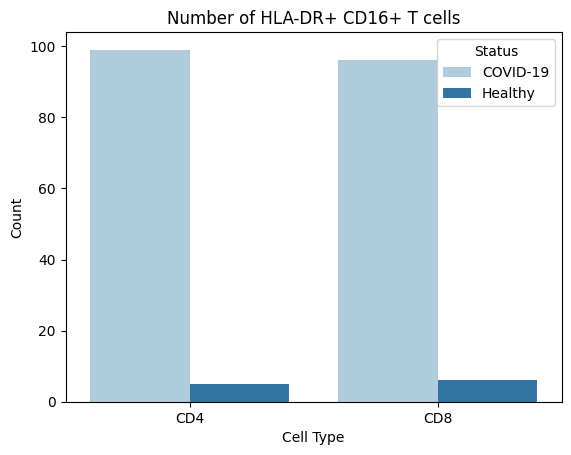

In [55]:
ax = sns.barplot(cv_count, x='Cell Type', y='Count', hue='Status', palette='Paired')
ax.set_title("Number of HLA-DR+ CD16+ T cells")
plt.savefig('../testsfigures/barplot_total_HLADR_CD16_Tcell_count.pdf')
plt.show()

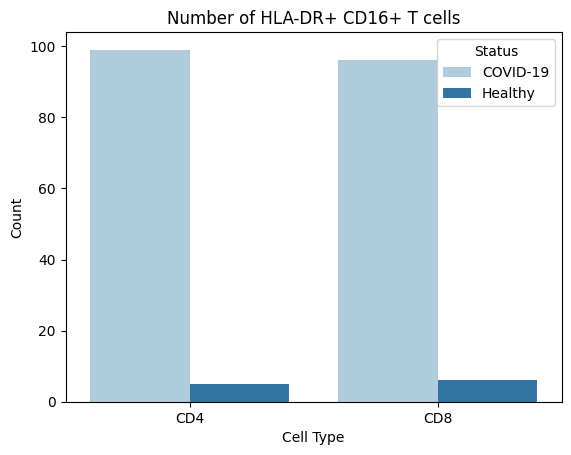

In [56]:
ax = sns.barplot(cv_count, x='Cell Type', y='Count', hue='Status', palette='Paired')
ax.set_title("Number of HLA-DR+ CD16+ T cells")
plt.savefig('../testsfigures/barplot_total_HLADR_CD16_Tcell_count.png')
plt.show()

Visualise HLA-DR+ CD16+ T cells on joint UMAP.

In [57]:
protein = mdata.mod['protein']

In [58]:
prob_cd16 = pdata.layers['protein_foreground_prob'][:, pdata.var_names =='AB_CD16'].squeeze()
prob_hladr = pdata.layers['protein_foreground_prob'][:, pdata.var_names =='AB_HLA-DR'].squeeze()

bool_mask = np.logical_and((prob_cd16>=0.4) & (prob_hladr>=0.4),  
                           pdata.obs['initial_clustering'].isin(cd4_comp))
bool_mask2 = np.logical_and((prob_cd16>=0.4) & (prob_hladr>=0.4),  
                            pdata.obs['initial_clustering'].isin(cd8_comp))

protein.obs['HLA-DR+ CD16+ T cells'] = 'other'
protein.obs['HLA-DR+ CD16+ T cells'][bool_mask] = 'HLA-DR+ CD16+ CD4+ T cell'
protein.obs['HLA-DR+ CD16+ T cells'][bool_mask2] = 'HLA-DR+ CD16+ CD8+ T cell'
protein.obs['HLA-DR+ CD16+ T cells'] = protein.obs['HLA-DR+ CD16+ T cells'].astype('category')

C:\Users\vfriedrich\AppData\Local\Temp\ipykernel_3916\577256724.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  protein.obs['HLA-DR+ CD16+ T cells'][bool_mask] = 'HLA-DR+ CD16+ CD4+ T cell'
C:\Users\vfriedrich\AppData\Local\Temp\ipykernel_3916\577256724.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  protein.obs['HLA-DR+ CD16+ T cells'][bool_mask2] = 'HLA-DR+ CD16+ CD8+ T cell'


In [59]:
protein.obs['HLA-DR+ CD16+ T cells'].value_counts()

other                        623882
HLA-DR+ CD16+ CD8+ T cell       245
HLA-DR+ CD16+ CD4+ T cell       198
Name: HLA-DR+ CD16+ T cells, dtype: int64

In [63]:
#pd.crosstab(protein.obs['HLA-DR+ CD16+ T cells'], mdata.mod['rna_subset'].obs['leiden_totalVI']).T

In [64]:
mdata

MuData object with n_obs × n_vars = 624325 × 27929
  3 modalities
    rna:	624325 x 24737
      obs:	'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'full_clustering', 'initial_clustering', 'Resample', 'Collection_Day', 'Sex', 'Age_interval', 'Swab_result', 'Status', 'Smoker', 'Status_on_day_collection', 'Status_on_day_collection_summary', 'Days_from_onset', 'Site', 'time_after_LPS', 'Worst_Clinical_Status', 'Outcome', 'patient_id'
      var:	'feature_types', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
      uns:	'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'umap'
      obsm:	'X_pca', 'X_pca_harmony', 'X_umap'
      layers:	'raw'
    protein:	624325 x 192
      obs:	'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'full_clustering', 'initial_clustering', 'Resample', 'Collection_Day', 'Sex', 'Age_interval', 'Swab_result', 'Status', 'Smoker', 'Status_on_day_collection', 'Status_on_day_collection_summary', 'Days_from_onset', 'Site', 'time_after_LPS', 'Worst_Clinical_Status', 'Outcome', 'patient_id', '_scvi_batch', 'leiden_totalVI', 'HLA-DR+ CD16+ T cells'
      var:	'feature_types'
      uns:	'hvg', 'leiden', 'neighbors', 'pca', 'umap', 'dendrogram_full_clustering', 'full_clustering_colors'
      obsm:	'X_pca', 'X_pca_harmony', 'X_umap'
      layers:	'denoised_protein', 'protein_foreground_prob', 'raw'
    rna_subset:	624325 x 3000
      obs:	'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'full_clustering', 'initial_clustering', 'Resample', 'Collection_Day', 'Sex', 'Age_interval', 'Swab_result', 'Status', 'Smoker', 'Status_on_day_collection', 'Status_on_day_collection_summary', 'Days_from_onset', 'Site', 'time_after_LPS', 'Worst_Clinical_Status', 'Outcome', 'patient_id', '_scvi_batch', 'leiden_totalVI'
      var:	'feature_types', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
      uns:	'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'umap', 'rna_subset:leiden_totalVI_colors', 'rna_subset:full_clustering_colors', 'rna_subset:initial_clustering_colors'
      obsm:	'X_pca', 'X_pca_harmony', 'X_totalVI', 'X_umap'
      layers:	'denoised_rna', 'raw'
      obsp:	'connectivities', 'distances'

In [65]:
protein.uns['CD16+ T cells_colors'] = ['#fd349a', '#92fab1', '#bbbbbb']

In [66]:
mdata.update()

C:\Users\vfriedrich\Anaconda3\envs\scanpy\lib\site-packages\mudata\_core\mudata.py:491: UserWarning: Cannot join columns with the same name because var_names are intersecting.
  warnings.warn(


C:\Users\vfriedrich\Anaconda3\envs\scanpy\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


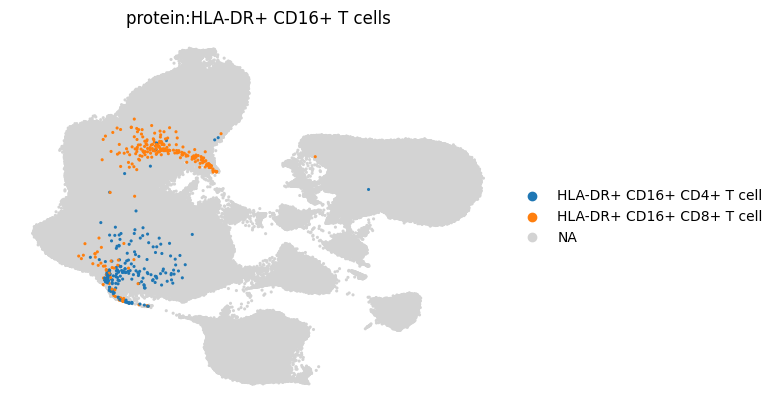

In [67]:
mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    #layer="protein",
    color='protein:HLA-DR+ CD16+ T cells',
    groups=['HLA-DR+ CD16+ CD8+ T cell', 'HLA-DR+ CD16+ CD4+ T cell'],
    frameon=False,
    ncols=3,
    size=20,
    wspace=0.1,
    save='HLADRpos_CD16pos_Tcells.pdf'
)

C:\Users\vfriedrich\Anaconda3\envs\scanpy\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


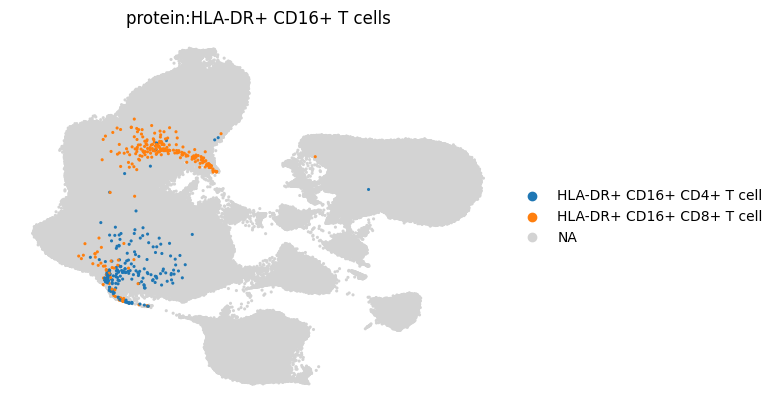

In [68]:
mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    #layer="protein",
    color='protein:HLA-DR+ CD16+ T cells',
    groups=['HLA-DR+ CD16+ CD8+ T cell', 'HLA-DR+ CD16+ CD4+ T cell'],
    frameon=False,
    ncols=3,
    size=20,
    wspace=0.1,
    save='HLADRpos_CD16pos_Tcells.png'
)

C:\Users\vfriedrich\Anaconda3\envs\scanpy\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


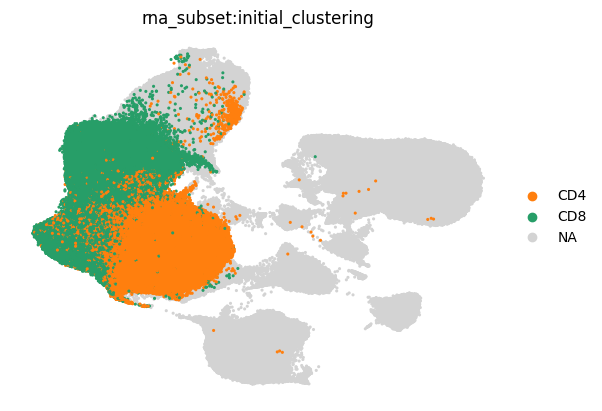

In [69]:
mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    #layer="protein",
    color='rna_subset:initial_clustering',
    groups=['CD8', 'CD4'],
    frameon=False,
    ncols=3,
    size=20,
    wspace=0.1)

In [54]:
mdata.update()

Write data to file.

In [70]:
mdata.write(f'{data_dir}haniffa21_totalVI_Covid_Healthy_annotated_HLADR+.h5mu')

C:\Users\vfriedrich\Anaconda3\envs\scanpy\lib\site-packages\mudata\_core\mudata.py:491: UserWarning: Cannot join columns with the same name because var_names are intersecting.
  warnings.warn(
